## Assignment 1: Machine Learning Methods

### \<your name> \<your id>

#### How can we use data analytics to predict energy usage for this house?

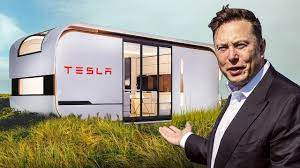


### 1. Read the dataset

In [11]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing, model_selection, metrics

import warnings
warnings.filterwarnings("ignore")


assign_1=pd.read_csv('./energydata_complete-1.csv')

### 2. Analyse and visualise the data

In [17]:
assign_1.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [18]:
assign_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [19]:
assign_1.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [20]:
assign_1.shape

(19735, 29)

In [21]:
assign_1.isnull().sum().sort_values(ascending=True)

date           0
Tdewpoint      0
Visibility     0
Windspeed      0
RH_out         0
Press_mm_hg    0
T_out          0
RH_9           0
T9             0
RH_8           0
T8             0
RH_7           0
T7             0
rv1            0
RH_6           0
RH_5           0
T5             0
RH_4           0
T4             0
RH_3           0
T3             0
RH_2           0
T2             0
RH_1           0
T1             0
lights         0
Appliances     0
T6             0
rv2            0
dtype: int64

In [22]:
from sklearn.model_selection import train_test_split
train,test=train_test_split(assign_1,test_size=0.25,random_state=42)

In [23]:
train.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,...,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000
mean,98.002838,3.828120,21.684882,40.258743,20.340154,40.422551,22.262874,39.243878,20.847201,39.040304,...,19.481392,41.564688,7.409235,755.535791,79.815677,4.031558,38.336201,3.770374,25.026830,25.026830
std,103.457709,7.983508,1.607712,3.964974,2.194775,4.069910,2.003559,3.248654,2.045689,4.332139,...,2.017567,4.157938,5.326024,7.380735,14.908459,2.438925,11.825196,4.199840,14.496293,14.496293
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.596667,17.200000,28.766667,15.100000,28.424286,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.006033,0.006033
25%,50.000000,0.000000,20.760000,37.363333,18.790000,37.900000,20.790000,36.900000,19.500000,35.566667,...,18.000000,38.518000,3.600000,750.933333,70.333333,2.000000,29.000000,0.900000,12.511717,12.511717
50%,60.000000,0.000000,21.600000,39.633333,20.000000,40.500000,22.100000,38.560000,20.600000,38.430000,...,19.390000,40.900000,6.900000,756.100000,84.000000,3.666667,40.000000,3.433333,24.930300,24.930300
75%,100.000000,0.000000,22.600000,43.060000,21.500000,43.290000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.363333,10.400000,760.966667,91.666667,5.333333,40.000000,6.583333,37.660334,37.660334
max,1080.000000,70.000000,26.260000,57.423333,29.856667,54.766667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.283333,100.000000,14.000000,66.000000,15.400000,49.996530,49.996530


In [24]:
col_temp = ["T1","T2","T3","T4","T5","T6","T7","T8","T9"]

col_hum = ["RH_1","RH_2","RH_3","RH_4","RH_5","RH_6","RH_7","RH_8","RH_9"]

col_weather = ["T_out", "Tdewpoint","RH_out","Press_mm_hg",
                "Windspeed","Visibility"] 
col_light = ["lights"]

col_randoms = ["rv1", "rv2"]

col_target = ["Appliances"]

In [25]:
feature_vars = train[col_temp + col_hum + col_weather + col_light + col_randoms ]
target_vars = train[col_target]

In [26]:
feature_vars.describe()

,T1,T2,T3,T4,T5,T6,T7,T8,T9,RH_1,...,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Visibility,lights,rv1,rv2
count,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,...,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000,14801.000000
mean,21.684882,20.340154,22.262874,20.847201,19.588907,7.902213,20.261409,22.026272,19.481392,40.258743,...,41.564688,7.409235,3.770374,79.815677,755.535791,4.031558,38.336201,3.828120,25.026830,25.026830
std,1.607712,2.194775,2.003559,2.045689,1.846895,6.100189,2.112339,1.955867,2.017567,3.964974,...,4.157938,5.326024,4.199840,14.908459,7.380735,2.438925,11.825196,7.983508,14.496293,14.496293
min,16.790000,16.100000,17.200000,15.100000,15.330000,-6.030000,15.390000,16.306667,14.890000,27.023333,...,29.166667,-5.000000,-6.600000,24.000000,729.300000,0.000000,1.000000,0.000000,0.006033,0.006033
25%,20.760000,18.790000,20.790000,19.500000,18.275000,3.590000,18.700000,20.790000,18.000000,37.363333,...,38.518000,3.600000,0.900000,70.333333,750.933333,2.000000,29.000000,0.000000,12.511717,12.511717
50%,21.600000,20.000000,22.100000,20.600000,19.390000,7.300000,20.000000,22.100000,19.390000,39.633333,...,40.900000,6.900000,3.433333,84.000000,756.100000,3.666667,40.000000,0.000000,24.930300,24.930300
75%,22.600000,21.500000,23.290000,22.100000,20.600000,11.233333,21.600000,23.390000,20.600000,43.060000,...,44.363333,10.400000,6.583333,91.666667,760.966667,5.333333,40.000000,0.000000,37.660334,37.660334
max,26.260000,29.856667,29.236000,26.200000,25.795000,28.290000,25.963333,27.230000,24.500000,57.423333,...,53.326667,26.100000,15.400000,100.000000,772.283333,14.000000,66.000000,70.000000,49.996530,49.996530


In [27]:
feature_vars.lights.value_counts()

0     11429
10     1655
20     1221
30      427
40       60
50        7
70        1
60        1
Name: lights, dtype: int64

In [28]:
target_vars.describe()

,Appliances
count,14801.000000
mean,98.002838
std,103.457709
min,10.000000
25%,50.000000
50%,60.000000
75%,100.000000
max,1080.000000


In [30]:
feature_vars.drop(['lights'],axis=1,inplace=True)


In [31]:
feature_vars.head(5)

,T1,T2,T3,T4,T5,T6,T7,T8,T9,RH_1,...,RH_8,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Visibility,rv1,rv2
8242,21.00,18.500000,20.230,19.926667,18.730000,5.000000,18.323333,20.890,17.500,38.163333,...,38.550000,36.533333,4.633333,0.600000,75.333333,755.033333,4.666667,40.000000,6.455464,6.455464
10603,21.00,18.390000,22.000,19.856667,19.323333,6.690000,20.230000,21.790,19.500,40.450000,...,43.526667,43.163333,6.416667,5.916667,97.000000,753.433333,6.000000,50.833333,6.797277,6.797277
18910,24.69,24.329730,26.834,23.997297,22.927027,22.394595,23.886486,24.416,23.176,49.476000,...,51.220000,48.400000,17.466667,14.433333,82.333333,751.533333,2.000000,40.000000,8.524160,8.524160
16772,23.79,21.633333,24.500,23.600000,21.100000,10.625714,22.790000,23.700,21.790,37.730000,...,43.200000,43.290000,12.033333,5.466667,64.666667,752.033333,1.000000,40.000000,25.197838,25.197838
16805,23.79,28.178000,25.100,23.600000,22.693333,23.730000,22.790000,23.600,22.200,39.326667,...,42.363333,42.760000,18.933333,8.850000,52.166667,752.466667,3.000000,40.000000,23.039471,23.039471


In [38]:
from chart_studio import plotly
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go

# To understand the timeseries variation of the applaince energy consumption
visData = go.Scatter( x= assign_1.date  ,  mode = "lines", y = assign_1.Appliances )
layout = go.Layout(title = 'Appliance energy consumption measurement' , xaxis=dict(title='Date'), yaxis=dict(title='(Wh)'))
fig = go.Figure(data=[visData],layout=layout)

iplot(fig)

In [43]:
assign_1['WEEKDAY'] = ((pd.to_datetime(assign_1['date']).dt.dayofweek)// 5 == 1).astype(float)
# There are 5472 weekend recordings 
assign_1['WEEKDAY'].value_counts()

0.0    14263
1.0     5472
Name: WEEKDAY, dtype: int64

In [44]:
temp_weekday =  assign_1[assign_1['WEEKDAY'] == 0]
# To understand the timeseries variation of the applaince energy consumption
visData = go.Scatter( x= temp_weekday.date  ,  mode = "lines", y = temp_weekday.Appliances )
layout = go.Layout(title = 'Appliance energy consumption measurement on weekdays' , xaxis=dict(title='Date'), yaxis=dict(title='(Wh)'))
fig = go.Figure(data=[visData],layout=layout)

iplot(fig)

In [45]:
temp_weekend =  assign_1[assign_1['WEEKDAY'] == 1]

# To understand the timeseries variation of the applaince energy consumption
visData = go.Scatter( x= temp_weekend.date  ,  mode = "lines", y = temp_weekend.Appliances )
layout = go.Layout(title = 'Appliance energy consumption measurement on weekend' , xaxis=dict(title='Date'), yaxis=dict(title='(Wh)'))
fig = go.Figure(data=[visData],layout=layout)

iplot(fig)

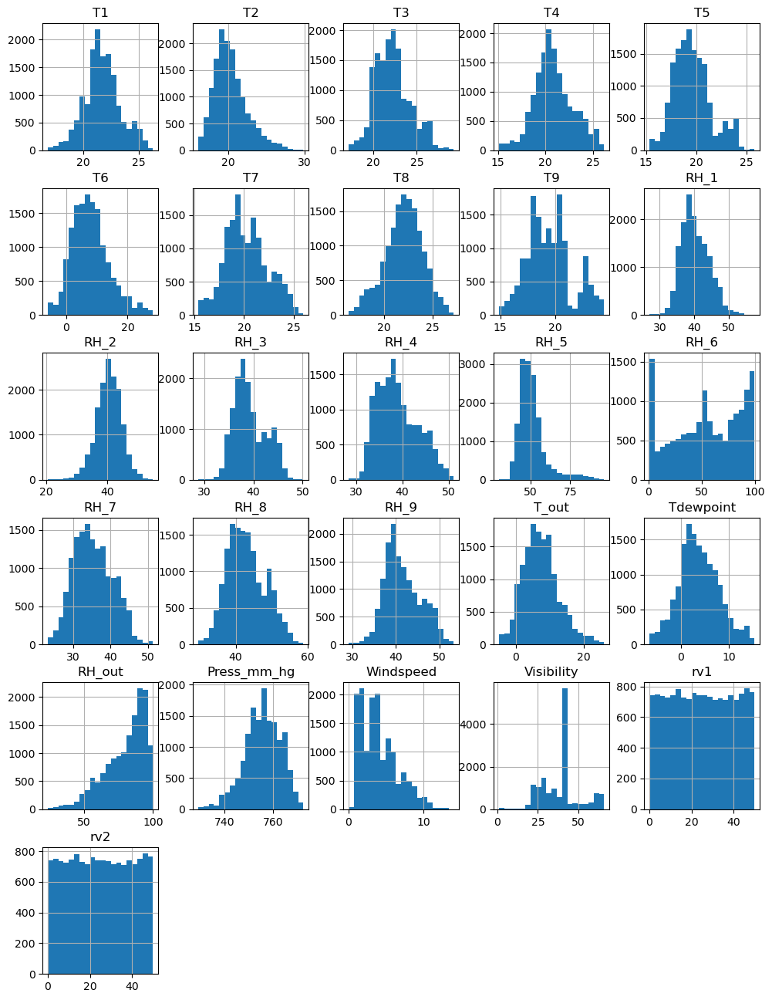

In [46]:
feature_vars.hist(bins = 20 , figsize= (12,16)) ;

In [89]:
sns.pairplot(assign_1)

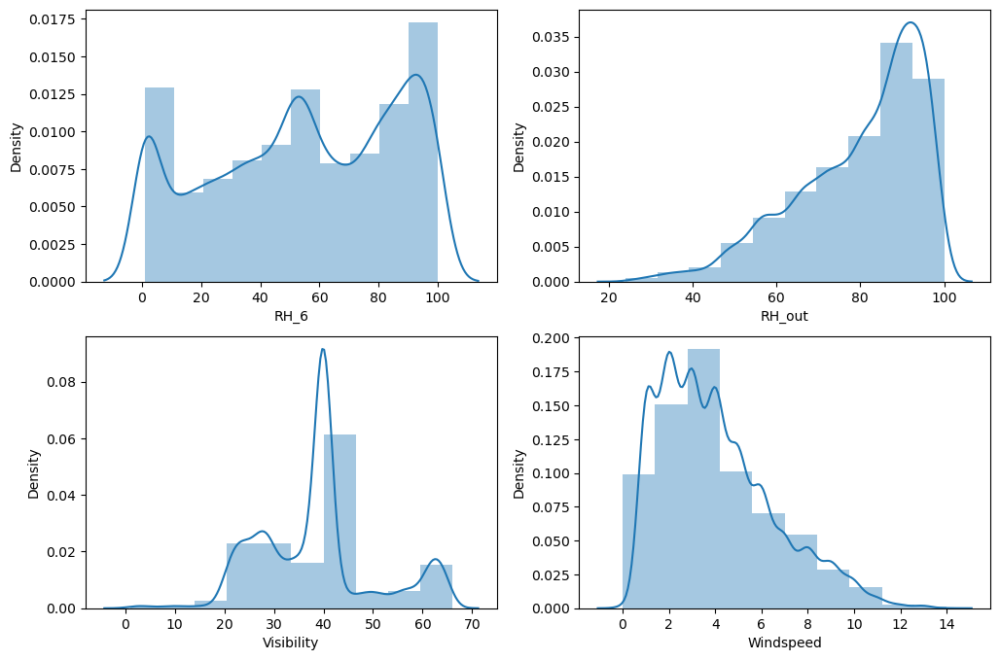

In [47]:
f, ax = plt.subplots(2,2,figsize=(12,8))
vis1 = sns.distplot(feature_vars["RH_6"],bins=10, ax= ax[0][0])
vis2 = sns.distplot(feature_vars["RH_out"],bins=10, ax=ax[0][1])
vis3 = sns.distplot(feature_vars["Visibility"],bins=10, ax=ax[1][0])
vis4 = sns.distplot(feature_vars["Windspeed"],bins=10, ax=ax[1][1])

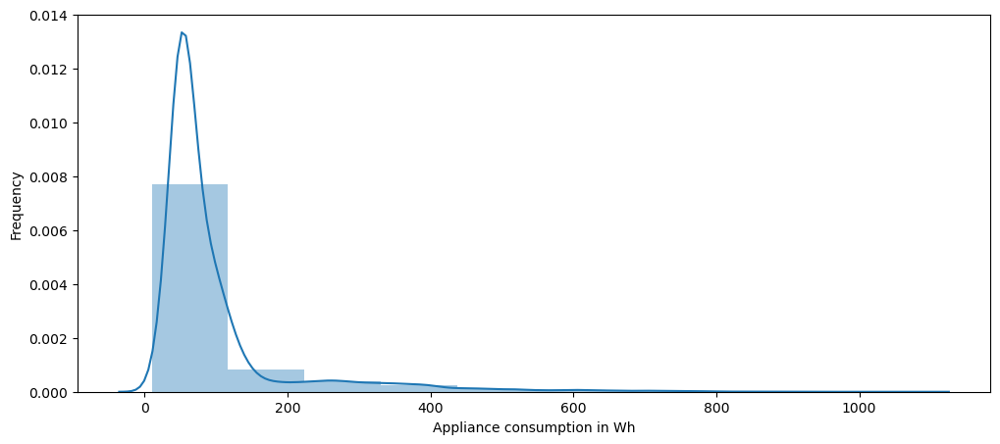

In [48]:
f = plt.figure(figsize=(12,5))
plt.xlabel('Appliance consumption in Wh')
plt.ylabel('Frequency')
sns.distplot(target_vars , bins=10 ) ;

In [49]:
print('Percentage of the appliance consumption is less than 200 Wh')
print(((target_vars[target_vars <= 200].count()) / (len(target_vars)))*100 )

Percentage of the appliance consumption is less than 200 Wh
Appliances    90.291197
dtype: float64


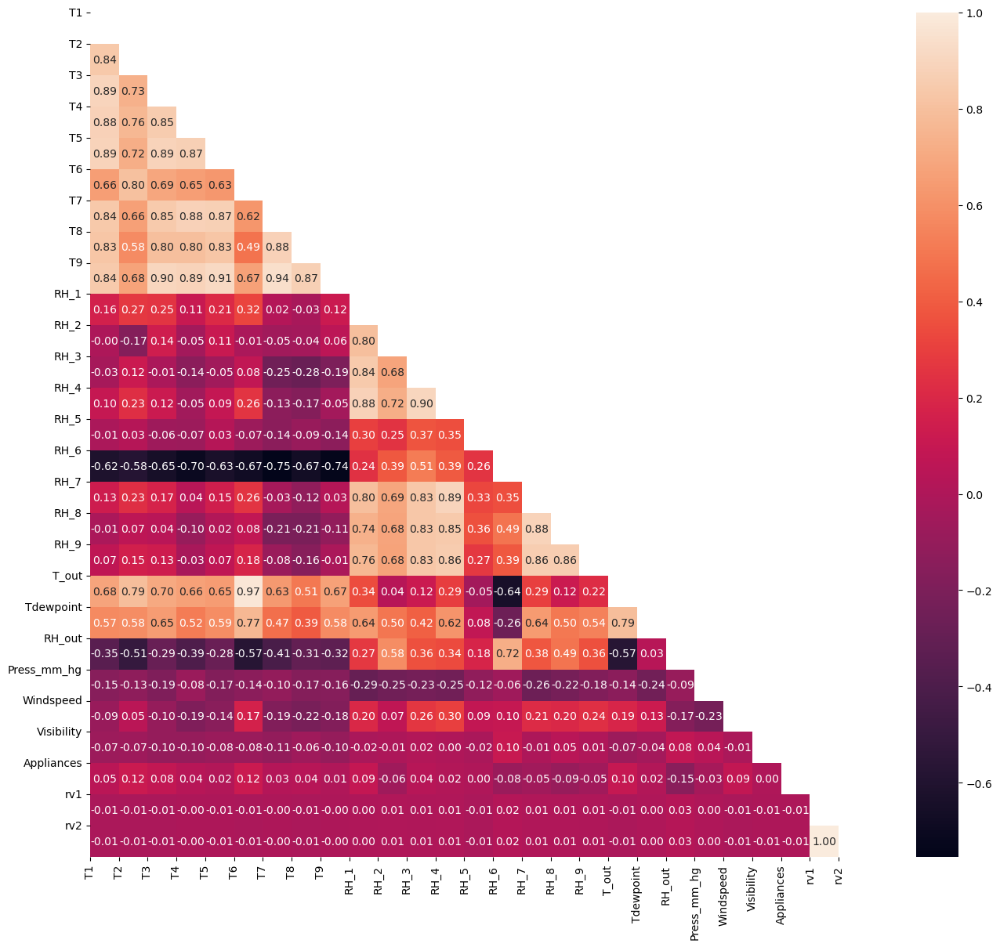

In [50]:
# Use the weather , temperature , applainces and random column to see the correlation
train_corr = train[col_temp + col_hum + col_weather +col_target+col_randoms]
corr = train_corr.corr()
# Mask the repeated values
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
  
f, ax = plt.subplots(figsize=(16, 14))
#Generate Heat Map, allow annotations and place floats in map
sns.heatmap(corr, annot=True, fmt=".2f" , mask=mask,)
    #Apply xticks
plt.xticks(range(len(corr.columns)), corr.columns);
    #Apply yticks
plt.yticks(range(len(corr.columns)), corr.columns)
    #show plot
plt.show()

In [51]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

# Function to get top correlations 

def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

print("Top Absolute Correlations")
print(get_top_abs_correlations(train_corr, 40))


Top Absolute Correlations
rv1    rv2          1.000000
T6     T_out        0.974996
T7     T9           0.944683
T5     T9           0.910924
T3     T9           0.902327
RH_3   RH_4         0.899665
RH_4   RH_7         0.894385
T1     T3           0.892386
T4     T9           0.890157
T3     T5           0.888455
T1     T5           0.885910
RH_7   RH_8         0.883725
T7     T8           0.882703
RH_1   RH_4         0.880386
T4     T7           0.878383
T1     T4           0.877274
T4     T5           0.872505
T5     T7           0.870636
T8     T9           0.869874
RH_7   RH_9         0.858151
RH_8   RH_9         0.856419
RH_4   RH_9         0.856063
T3     T4           0.853219
       T7           0.848788
RH_4   RH_8         0.848108
RH_1   RH_3         0.844879
T1     T9           0.844449
       T7           0.839018
       T2           0.836712
RH_3   RH_9         0.834587
       RH_7         0.834040
       RH_8         0.831325
T1     T8           0.827216
T5     T8        

In [52]:
#Split training dataset into independent and dependent varibales
train_X = train[feature_vars.columns]
train_y = train[target_vars.columns]
#Split testing dataset into independent and dependent varibales
test_X = test[feature_vars.columns]
test_y = test[target_vars.columns]
# Due to conlusion made above below columns are removed
train_X.drop(["rv1","rv2","Visibility","T6","T9"],axis=1 , inplace=True)
# Due to conlusion made above below columns are removed
test_X.drop(["rv1","rv2","Visibility","T6","T9"], axis=1, inplace=True)

In [53]:
train_X.columns

Index(['T1', 'T2', 'T3', 'T4', 'T5', 'T7', 'T8', 'RH_1', 'RH_2', 'RH_3',
       'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 'RH_9', 'T_out', 'Tdewpoint',
       'RH_out', 'Press_mm_hg', 'Windspeed'],
      dtype='object')

In [54]:
test_X.columns

Index(['T1', 'T2', 'T3', 'T4', 'T5', 'T7', 'T8', 'RH_1', 'RH_2', 'RH_3',
       'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 'RH_9', 'T_out', 'Tdewpoint',
       'RH_out', 'Press_mm_hg', 'Windspeed'],
      dtype='object')

In [55]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()

# Create test and training set by including Appliances column

train = train[list(train_X.columns.values) + col_target ]

test = test[list(test_X.columns.values) + col_target ]

# Create dummy test and training set to hold scaled values

sc_train = pd.DataFrame(columns=train.columns , index=train.index)

sc_train[sc_train.columns] = sc.fit_transform(train)

sc_test= pd.DataFrame(columns=test.columns , index=test.index)

sc_test[sc_test.columns] = sc.fit_transform(test)

In [56]:
sc_train.head()

,T1,T2,T3,T4,T5,T7,T8,RH_1,RH_2,RH_3,...,RH_6,RH_7,RH_8,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Appliances
8242,-0.426012,-0.838453,-1.014666,-0.450003,-0.465070,-0.917533,-0.580975,-0.528498,-0.023560,-0.382903,...,0.744515,-0.640976,-0.842361,-1.210101,-0.521214,-0.754905,-0.300668,-0.068079,0.260414,-0.560662
10603,-0.426012,-0.888574,-0.131208,-0.484222,-0.143800,-0.014870,-0.120806,0.048238,0.901144,-0.293632,...,0.612065,0.636348,0.110013,0.384493,-0.186368,0.511059,1.152695,-0.284867,0.807122,-0.560662
18910,1.869253,1.817822,2.281580,1.539923,1.807484,1.716202,1.221866,2.324748,1.655242,1.414825,...,-1.056388,1.657680,1.582269,1.643974,1.888420,2.538982,0.168880,-0.542303,-0.833001,-0.367340
16772,1.309432,0.589228,1.116614,1.345704,0.818208,1.197098,0.855776,-0.637792,-0.333160,-0.343911,...,-1.002991,-0.256931,0.047499,0.414958,0.868238,0.403908,-1.016170,-0.474557,-1.243032,-0.560662
16805,1.309432,3.571260,1.416091,1.345704,1.680946,1.197098,0.804646,-0.235086,-2.222864,-0.601463,...,-1.722647,-0.098977,-0.112612,0.287487,2.163807,1.209522,-1.854648,-0.415843,-0.422970,0.019305


In [57]:
sc_test.head()

,T1,T2,T3,T4,T5,T7,T8,RH_1,RH_2,RH_3,...,RH_6,RH_7,RH_8,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Appliances
8980,-0.500678,-1.181417,-0.989146,-0.550440,-0.545068,0.625724,0.526893,-1.209044,-0.307333,-0.714600,...,0.306806,-0.327972,-0.601874,-0.601549,-1.068187,-0.892988,0.590075,1.799696,-0.695857,-0.569601
2754,0.123890,0.432255,-0.322042,-0.170284,-1.046887,-1.614094,-0.726074,3.191796,1.215371,3.052404,...,1.378408,0.781883,0.895409,0.649691,-0.891803,-0.605831,0.702103,-0.118447,-0.427859,-0.067939
9132,-0.188394,-1.239320,-0.305488,-0.289902,-0.000926,0.240532,0.031881,-1.184181,0.028497,-1.234117,...,-0.108275,-1.572938,-0.625022,-0.780644,-1.364260,-1.467302,0.231585,1.437529,-0.829856,-0.469268
14359,-0.188394,1.620795,-0.123400,0.742417,0.017212,-0.111371,-0.428002,0.191600,-1.369704,-0.704414,...,-1.416959,-0.967385,-0.919402,-0.715298,0.270444,-0.003599,-0.586219,1.652146,0.443136,-0.469268
8875,-1.079444,-1.774163,-1.133161,-0.796230,-0.931408,0.050314,0.031881,-1.277005,-0.070613,-0.867399,...,0.545530,-0.250488,-0.632046,-0.197377,-1.490249,-1.239969,0.926159,1.900298,-0.025861,-0.268604


In [58]:
train_X =  sc_train.drop(['Appliances'] , axis=1)
train_y = sc_train['Appliances']

test_X =  sc_test.drop(['Appliances'] , axis=1)
test_y = sc_test['Appliances']

In [59]:
train_X.head()

,T1,T2,T3,T4,T5,T7,T8,RH_1,RH_2,RH_3,...,RH_5,RH_6,RH_7,RH_8,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed
8242,-0.426012,-0.838453,-1.014666,-0.450003,-0.465070,-0.917533,-0.580975,-0.528498,-0.023560,-0.382903,...,-0.682602,0.744515,-0.640976,-0.842361,-1.210101,-0.521214,-0.754905,-0.300668,-0.068079,0.260414
10603,-0.426012,-0.888574,-0.131208,-0.484222,-0.143800,-0.014870,-0.120806,0.048238,0.901144,-0.293632,...,-0.156601,0.612065,0.636348,0.110013,0.384493,-0.186368,0.511059,1.152695,-0.284867,0.807122
18910,1.869253,1.817822,2.281580,1.539923,1.807484,1.716202,1.221866,2.324748,1.655242,1.414825,...,0.182199,-1.056388,1.657680,1.582269,1.643974,1.888420,2.538982,0.168880,-0.542303,-0.833001
16772,1.309432,0.589228,1.116614,1.345704,0.818208,1.197098,0.855776,-0.637792,-0.333160,-0.343911,...,-0.312659,-1.002991,-0.256931,0.047499,0.414958,0.868238,0.403908,-1.016170,-0.474557,-1.243032
16805,1.309432,3.571260,1.416091,1.345704,1.680946,1.197098,0.804646,-0.235086,-2.222864,-0.601463,...,3.457568,-1.722647,-0.098977,-0.112612,0.287487,2.163807,1.209522,-1.854648,-0.415843,-0.422970


In [60]:
train_y.head()

8242    -0.560662
10603   -0.560662
18910   -0.367340
16772   -0.560662
16805    0.019305
Name: Appliances, dtype: float64

Analyse and Visualize the data:
The dependent variable here is Appliance because the usage of electricity changes accordingly to the difference in other parameters. When looking at the histogram of the columns, a few were dropped for efficient training. The prediction models used for this dataset were Support Vector Machine with Radial basis Function and Random Forest Regressor as the values are not continuous. The heat map correlation shows that there are variables with less correlation with few variables, but no variable can be dropped. There was no need for imputation because there were no missing values. The training set and the test set were taken at a 70 to 30 ratio. The charts and diagram support my argument.
  

### 3. Implement prediction models

In [94]:
from sklearn.linear_model import Ridge,Lasso
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor

In [95]:
models=[
    ['Lasso :',Lasso()],
    ['Ridge :',Ridge()],
    ['SVR :', SVR(kernel='rbf')],
    ['RandomForest :',RandomForestRegressor()]
]

In [96]:
import time
from math import sqrt
from sklearn.metrics import mean_squared_error

model_data = []
for name,curr_model in models :
    curr_model_data = {}
    curr_model.random_state = 78
    curr_model_data["Name"] = name
    start = time.time()
    curr_model.fit(train_X,train_y)
    end = time.time()
    curr_model_data["Train_Time"] = end - start
    curr_model_data["Train_R2_Score"] = metrics.r2_score(train_y,curr_model.predict(train_X))
    curr_model_data["Test_R2_Score"] = metrics.r2_score(test_y,curr_model.predict(test_X))
    curr_model_data["Test_RMSE_Score"] = sqrt(mean_squared_error(test_y,curr_model.predict(test_X)))
    model_data.append(curr_model_data)

In [97]:
model_data

[{'Name': 'Lasso :',
  'Train_Time': 0.009203433990478516,
  'Train_R2_Score': 0.0,
  'Test_R2_Score': 0.0,
  'Test_RMSE_Score': 1.0},
 {'Name': 'Ridge :',
  'Train_Time': 0.004999876022338867,
  'Train_R2_Score': 0.13687066483380939,
  'Test_R2_Score': 0.12458197202967525,
  'Test_RMSE_Score': 0.9356377653613202},
 {'Name': 'SVR :',
  'Train_Time': 8.612324953079224,
  'Train_R2_Score': 0.23833290566993082,
  'Test_R2_Score': 0.2163932202486042,
  'Test_RMSE_Score': 0.8852156684963253},
 {'Name': 'RandomForest :',
  'Train_Time': 21.35348391532898,
  'Train_R2_Score': 0.941160942838737,
  'Test_R2_Score': 0.5618102598567951,
  'Test_RMSE_Score': 0.6619590169664622}]

In [98]:
dataframe=pd.DataFrame(model_data)

In [99]:
dataframe

,Name,Train_Time,Train_R2_Score,Test_R2_Score,Test_RMSE_Score
0,Lasso :,0.009203,0.000000,0.000000,1.000000
1,Ridge :,0.005000,0.136871,0.124582,0.935638
2,SVR :,8.612325,0.238333,0.216393,0.885216
3,RandomForest :,21.353484,0.941161,0.561810,0.661959


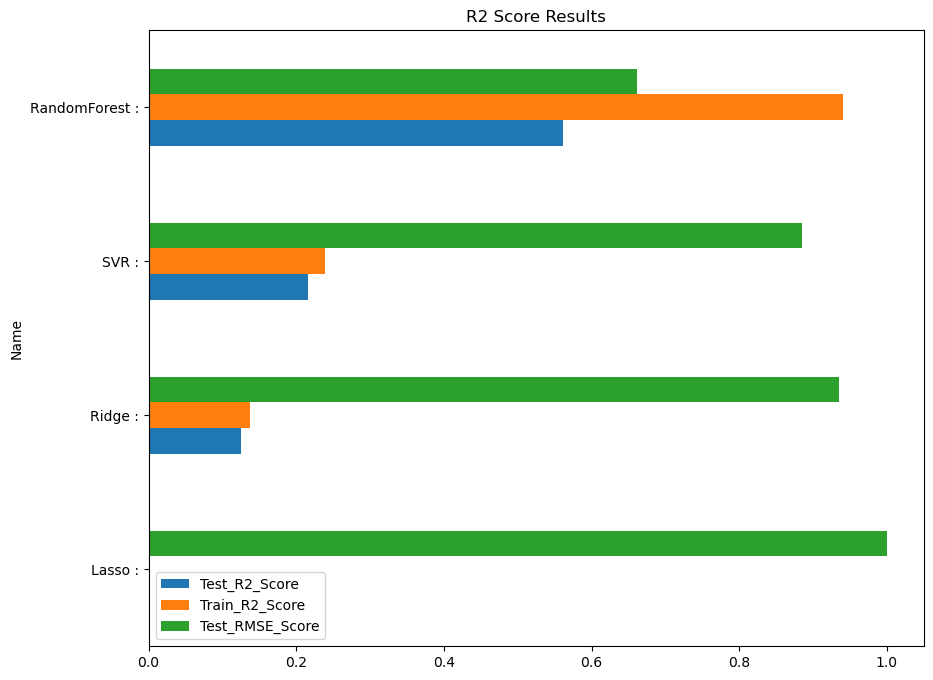

In [100]:
dataframe.plot(x="Name", y=['Test_R2_Score' , 'Train_R2_Score' , 'Test_RMSE_Score'], kind="barh" , title = 'R2 Score Results' , figsize= (10,8)) ;

In [101]:
from sklearn import utils
lab=preprocessing.LabelEncoder()
y_t=lab.fit_transform(train_y)
y_ts=lab.fit_transform(test_y)

Training and Testing Methodlogy:
  The training and testing done here was RMSE i.e Root Mean Square Error to evaluate the quality of the predictions. Training and Testing dataset was done with same dataset with dropped columns that didnt add any value to the prediction.

### 4. Train prediction models

In [102]:
from sklearn.svm import SVC
classifier=SVC(kernel="rbf")
classifier.fit(train_X,y_t)

SVC()

In [103]:
import sklearn.ensemble as skle

rfc=skle.RandomForestRegressor(100)
rfc.fit(train_X,y_t)

RandomForestRegressor()

### 5. Test predictin models and show results

In [105]:
from sklearn.metrics import accuracy_score
y_pred=classifier.predict(test_X)
accuracy_score(y_ts,y_pred)

0.2815160113498176

In [104]:
print(rfc.score(test_X,y_ts))

0.570903342438948


The performance metrics used here is RMSE root mean square error because the RMSE is the most commonly used yet highly effective evaluator of the prediction. The prediction models had score metrics to analyze and evalutate the accuracy of the predicted values to the original values.

### 6. Compare the results from all candidate models, choose the best model, justify your choice and discuss the results

The Training and prediction models used were SVM with Radial basis function and Random forest Regressor. Out of the two Models used for prediction of the Energy consumption. The Random Forest Regressor is better because they predict the Variance with 57% accuracy whereas the svm with radial basis function could predict only 28% of the variance. The best Model, according to the paper was gradient boosting machines with high accuracy. The accuracy of Random Forest Regressor is the Untuned model. The result could further improve when the model is tuned using GridSearchCV. Feature Reduction or Dimensionality reducing caused reduction in prediction which means that no variable can be dropped. with can be proved by Feature Importance. The final model had 22 features and accuracy of 57%.

### 7. Reflect on what you have learned by completing this assignment

This Assignment had thought me a lot of things about how a dataset should be pre-processed, the different viewpoint of viewing a data and exploring them with the appropriate tools. It also taught me a lot about correlation and how every independent variable can be useful in prediciting a dependent variable. I have learned more about the types of models and the dependencies. The terminologies used for professional communication. The usage of Heatmap for finding out the correlation of the variables. Using Appropriate algorithm for different types of problems.

### 8. References